In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
pd.set_option('display.max_columns', None)

In [13]:
df = pd.read_csv('..\data\dataset_new_score_v3.csv', index_col=0)
df.head()

,titre,budget,recette,duree,realisateur,casting,compagnies_production,suite,Comedy,Drama,Horror,Thriller,Action,Adventure,Science Fiction,Fantasy,Family,Crime,Romance,Animation,Mystery,War,Music,Western,History,Documentary,TV Movie,benefice global,saison,casting_score_sum,casting_score_mean,casting_score_med,casting_score_min,casting_score_max,director_score_sum,director_score_mean,director_score_med,director_score_min,director_score_max,compagnies_score_sum,compagnies_score_mean,compagnies_score_med,compagnies_score_min,compagnies_score_max
0,Dumb and Dumber To,40000000,169837010,110,"['Bobby Farrelly', 'Peter Farrelly']","['Jim Carrey', 'Jeff Daniels', 'Laurie Holden'...","['New Line Cinema', 'Universal Pictures', 'Con...",3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,324.592525,2,79,1.179104,0,0,38,27,13.5,13,13,14,135,33.75,18,0,99
1,Марс,2000000,240000,100,['Anna Melikyan'],"['Nana Kiknadze', 'Artur Smolyaninov', 'Yevgen...","['Central Partnership', 'Studio SLON']",1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-88.000000,2,0,0.000000,0,0,0,0,0.0,0,0,0,0,0.00,0,0,0
2,Captain America: The Winter Soldier,170000000,714766572,136,"['Anthony Russo', 'Joe Russo']","['Chris Evans', 'Scarlett Johansson', 'Sebasti...",['Marvel Studios'],2,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,320.450925,0,459,7.061538,0,0,100,128,64.0,64,64,64,81,81.00,81,81,81
3,Тот ещё Карлосон!,4000000,9938268,80,['Sarik Andreasyan'],"['Mikhail Galustyan', 'Igor Vernik', 'Mariya S...",['Enjoy Movies'],1,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,148.456700,3,0,0.000000,0,0,0,0,0.0,0,0,0,0,0.00,0,0,0
4,The Saint,68000000,118063304,116,['Phillip Noyce'],"['Val Kilmer', 'Elisabeth Shue', 'Rade Šerbedž...","['Paramount', 'Mace Neufeld Productions', 'Rys...",1,0,0,0,1,1,1,1,0,0,0,1,0,0,0,0,0,0,0,0,73.622506,0,25,0.862069,0,0,8,11,11.0,11,11,11,9,3.00,0,0,9


In [14]:
df['compagnies_score_mean'] = df['compagnies_score_mean'].map(int)
df['casting_score_mean'] = df['casting_score_mean'].map(int)
df['director_score_mean'] = df['director_score_mean'].map(int)
df['benefice global'] = df['benefice global'].map(int)
df.drop(columns = ['titre', 'realisateur', 'casting', 'compagnies_production', 'recette', "director_score_mean", "director_score_med", "director_score_min",
 "director_score_max", "compagnies_score_mean", "compagnies_score_med", "compagnies_score_min", "compagnies_score_max"], inplace = True)

In [15]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestClassifier
import pandas as pd
import numpy as np
from random import shuffle
from sklearn.metrics import precision_score, recall_score, classification_report, confusion_matrix, accuracy_score
from sklearn.model_selection import KFold, GridSearchCV, cross_val_score

In [16]:
df['tranche benef'] = 0
df.loc[df['benefice global'] >= df['benefice global'].quantile(0.25), 'tranche benef'] = 1
df.loc[df['benefice global'] >= df['benefice global'].quantile(0.5), 'tranche benef'] = 2
df.loc[df['benefice global'] >= df['benefice global'].quantile(0.75), 'tranche benef'] = 3

In [17]:
X = df.drop(columns = ['tranche benef', 'benefice global'])
Y = df['tranche benef']

In [18]:
data_dmatrix = xgb.DMatrix(data=X,label=Y)

In [19]:
from sklearn.model_selection import train_test_split

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=123)

In [20]:
# Instatiate a XGBClassifier
params = { "objective": "multi:softmax", 'num_class': 4}
xgb_clf = xgb.XGBRegressor(**params)

## Set max_depth to be 10 instead of 100
xgb_clf.set_params(n_estimators=100)

# Fit it to the training set
xgb_clf.fit(X_train, Y_train)

# Predict the labels of the test set
preds = xgb_clf.predict(X_test)



In [21]:
## Set max_depth to be 10 instead of 100
xgb_clf.set_params(n_estimators=10)

# Fit it to the training set
xgb_clf.fit(X_train, Y_train)

# Predict the labels of the test set
preds = xgb_clf.predict(X_test)

In [22]:
print(classification_report(Y_test, preds))

              precision    recall  f1-score   support

           0       0.45      0.57      0.50       237
           1       0.37      0.26      0.31       246
           2       0.37      0.33      0.35       237
           3       0.42      0.47      0.45       219

    accuracy                           0.41       939
   macro avg       0.40      0.41      0.40       939
weighted avg       0.40      0.41      0.40       939



In [23]:
df['tranche benef binaire'] = 0
df.loc[df['benefice global'] > 0, 'tranche benef binaire'] = 1
df['tranche benef binaire'].value_counts()

1    3122
0    1573
Name: tranche benef binaire, dtype: int64

In [24]:
X_bin = df.drop(columns = ['tranche benef', 'benefice global', 'tranche benef binaire'])
Y_bin = df['tranche benef binaire']

In [25]:
X_train_bin, X_test_bin, Y_train_bin, Y_test_bin = train_test_split(X_bin, Y_bin, test_size=0.2, random_state=123)

In [26]:
# Instatiate a XGBClassifier
params = { "objective": "multi:softmax", 'num_class': 2}
xgb_clf = xgb.XGBRegressor(**params)

## Set max_depth to be 10 instead of 100
xgb_clf.set_params(n_estimators=100)

# Fit it to the training set
xgb_clf.fit(X_train_bin, Y_train_bin)

# Predict the labels of the test set
preds_bin = xgb_clf.predict(X_test_bin)

In [27]:
print(classification_report(Y_test_bin, preds_bin))

              precision    recall  f1-score   support

           0       0.53      0.40      0.46       331
           1       0.71      0.81      0.76       608

    accuracy                           0.66       939
   macro avg       0.62      0.60      0.61       939
weighted avg       0.65      0.66      0.65       939



In [28]:
def print_score(clf, X_train, y_train, X_test, y_test, train=True):
    if train:
        pred = clf.predict(X_train)
        clf_report = pd.DataFrame(classification_report(y_train, pred, output_dict=True))
        print("Train Result:\n================================================")
        print(f"Accuracy Score: {accuracy_score(y_train, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_train, pred)}\n")
        
    elif train==False:
        pred = clf.predict(X_test)
        clf_report = pd.DataFrame(classification_report(y_test, pred, output_dict=True))
        print("Test Result:\n================================================")        
        print(f"Accuracy Score: {accuracy_score(y_test, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_test, pred)}\n")

In [18]:
n_estimators = [100]
max_features = ['auto']
max_depth = [2, 3, 5]
max_depth.append(None)
min_samples_split = [2, 5]
min_samples_leaf = [1, 2, 4]
bootstrap = [True]

params_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf, 'bootstrap': bootstrap}

rf_clf = RandomForestClassifier(random_state=42)

rf_cv = GridSearchCV(rf_clf, params_grid, scoring="accuracy", cv=3, verbose=2, n_jobs=-1)


rf_cv.fit(X_train_bin, Y_train_bin)
best_params = rf_cv.best_params_
print(f"Best parameters: {best_params}")

rf_clf = RandomForestClassifier(**best_params)
rf_clf.fit(X_train_bin, Y_train_bin)

print_score(rf_clf, X_train_bin, Y_train_bin, X_test_bin, Y_test_bin, train=True)
print_score(rf_clf, X_train_bin, Y_train_bin, X_test_bin, Y_test_bin, train=False)

Fitting 3 folds for each of 24 candidates, totalling 72 fits


KeyboardInterrupt: 

In [29]:
best_params = {'bootstrap': True, 'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 100}

rf_clf = RandomForestClassifier(**best_params)
rf_clf.fit(X_train_bin, Y_train_bin)


print_score(rf_clf, X_train_bin, Y_train_bin, X_test_bin, Y_test_bin, train=True)
print_score(rf_clf, X_train_bin, Y_train_bin, X_test_bin, Y_test_bin, train=False)

Train Result:
Accuracy Score: 85.76%
_______________________________________________
CLASSIFICATION REPORT:
                     0            1  accuracy    macro avg  weighted avg
precision     0.933742     0.836450  0.857561     0.885096      0.868622
recall        0.612721     0.978520  0.857561     0.795621      0.857561
f1-score      0.739912     0.901925  0.857561     0.820919      0.848352
support    1242.000000  2514.000000  0.857561  3756.000000   3756.000000
_______________________________________________
Confusion Matrix: 
 [[ 761  481]
 [  54 2460]]

Test Result:
Accuracy Score: 69.44%
_______________________________________________
CLASSIFICATION REPORT:
                    0           1  accuracy   macro avg  weighted avg
precision    0.674603    0.697417  0.694356    0.686010      0.689375
recall       0.256798    0.932566  0.694356    0.594682      0.694356
f1-score     0.371991    0.798030  0.694356    0.585010      0.647850
support    331.000000  608.000000  0.694356 

In [30]:
import shap

explainer = shap.explainers.Tree(rf_clf)

shap_values = explainer.shap_values(X_train_bin)


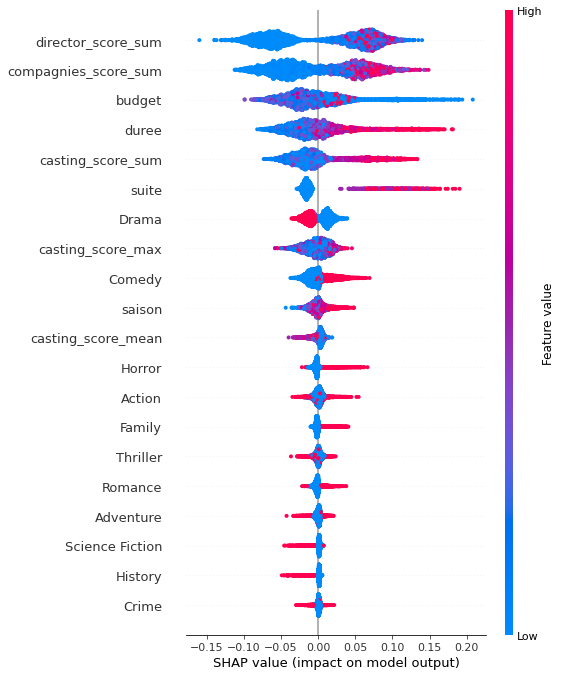

In [31]:
shap.initjs()
shap.summary_plot(shap_values[1], X_train_bin)

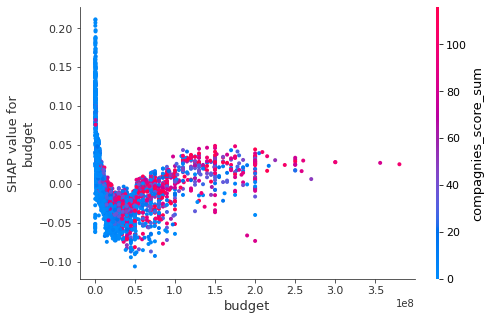

None


In [39]:
print(shap.dependence_plot('budget', shap_values[1], X_train_bin))

In [32]:
X.columns

Index(['budget', 'duree', 'suite', 'Comedy', 'Drama', 'Horror', 'Thriller',
       'Action', 'Adventure', 'Science Fiction', 'Fantasy', 'Family', 'Crime',
       'Romance', 'Animation', 'Mystery', 'War', 'Music', 'Western', 'History',
       'Documentary', 'TV Movie', 'saison', 'casting_score_sum',
       'casting_score_mean', 'casting_score_med', 'casting_score_min',
       'casting_score_max', 'director_score_sum', 'compagnies_score_sum'],
      dtype='object')

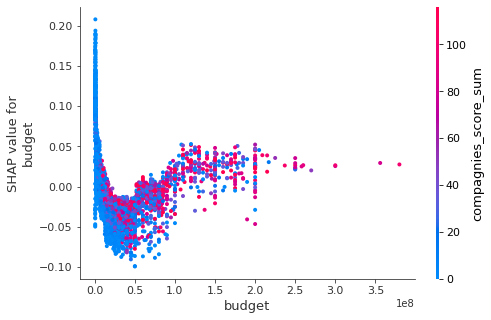

None


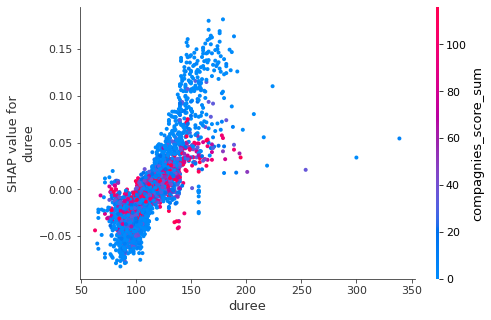

None


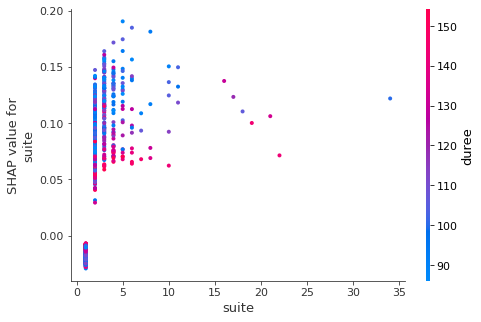

None


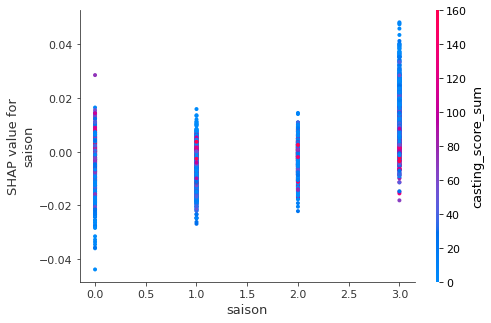

None


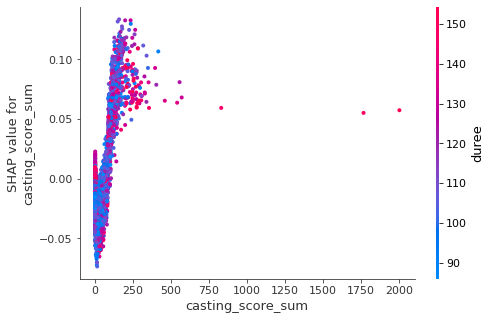

None


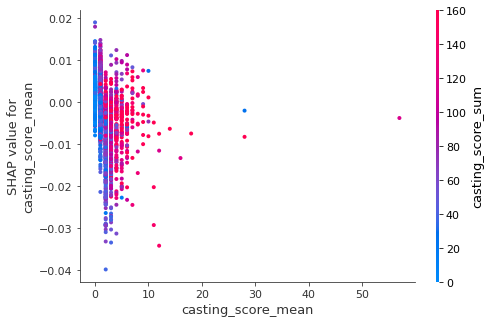

None


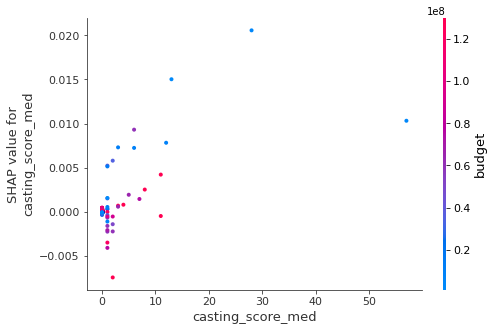

None


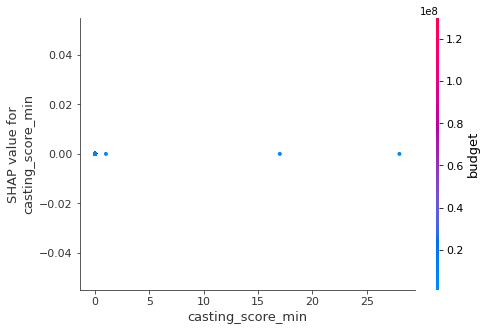

None


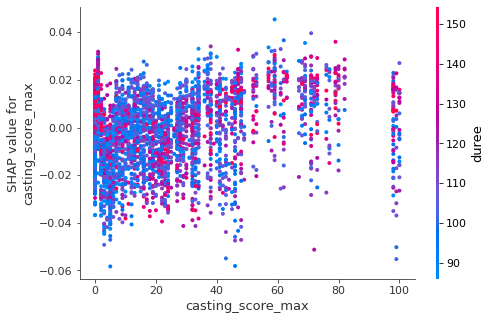

None


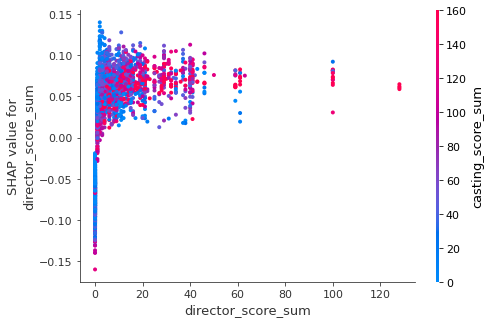

None


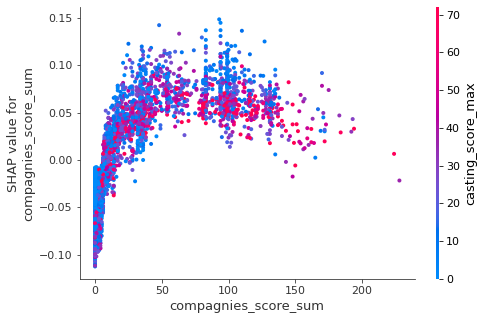

None


In [33]:
genres = ['Comedy', 'Drama', 'Horror', 'Thriller',
       'Action', 'Adventure', 'Science Fiction', 'Fantasy', 'Family', 'Crime',
       'Romance', 'Animation', 'Mystery', 'War', 'Music', 'Western', 'History',
       'Documentary', 'TV Movie']

for column in X.columns:
    if column not in genres : 
        print(shap.dependence_plot(column, shap_values[1], X_train_bin))

In [ ]:
shap.decision_plot()

In [56]:
# load JS visualization code to notebook
shap.initjs()
# visualize the first prediction’s explanation
i=50
shap.force_plot(explainer.expected_value[1], shap_values[1][i], X_train_bin.values[i], feature_names = X.columns)

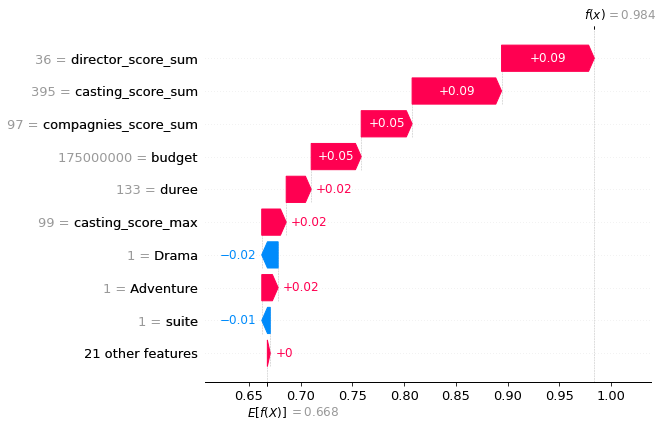

In [59]:
# load JS visualization code to notebook
shap.initjs()
# visualize the training set predictions
i=50
shap.waterfall_plot(shap.Explanation(values=shap_values[1][i], base_values = explainer.expected_value[1], data = X_train_bin.values[i], feature_names = X.columns ))

In [60]:
from lime import lime_tabular

lime_explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train_bin),
    feature_names=X_train_bin.columns,
    class_names=['0', '1'],
    mode='classification'
)
for i in range(20):
    test_1 = X_test_bin.iloc[i]
    lime_exp = lime_explainer.explain_instance(
        data_row=test_1,
        predict_fn=rf_clf.predict_proba,num_features=30
    )
    lime_exp.show_in_notebook(show_table=True)